# ALL RESULTS OF CLASSIFICATION

In [1]:
import sys
sys.path.append('..')

In [2]:
import torch
from celeb_classifier import MLPClassifierWrapper
from facenet_pytorch import InceptionResnetV1
from src.data_loader import FairFaceData, CelebData
from src.models import transformation, get_pretrained_model
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_pil_image

c:\Users\johnd\anaconda3\envs\computer_vision\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:

def get_metrics(path):
    metrics = pd.read_csv(path)
    print(f"Untrained Test Accuracy:\t{metrics['test_acc'][0] * 100:.4f}%")
    print(f"Final Test Accuracy:\t\t{metrics['test_acc'].to_numpy()[-1] * 100:.4f}%")

def plot_sample(model, sample, transform, device):
    model = model.to(device)
    model.eval()
    fig, axes = plt.subplots(2, 5, figsize = (30, 15))
    axes = axes.flatten()
    with torch.no_grad():
        for idx, ax in enumerate(axes):
            img, y = sample[idx]
            if y.item() == -1 or y.item() == 0:
                y = 0
            else:
                y = 1
            x = transform(img)
            x = x.to(device)
            yhat = model(x.unsqueeze(0))
            ax.set_title(f'Predicted: {round(yhat.item())}, Truth: {y}')
            ax.imshow(img)
    fig.show()

In [4]:
root = Path('..')
result_root = root / 'results'

In [5]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Using {device} for inference')

Using cuda for inference


In [6]:
# load sample dataset
celeb_sample = CelebData(root = str(root), sample = True)

# Initial Model Selection

VGGFACE2

In [7]:
vgg_result_path = result_root / 'celeb_results_vggface2' / 'lightning_logs' / 'version_0'

In [8]:
get_metrics(str(vgg_result_path / 'metrics.csv'))

Untrained Test Accuracy:	39.0191%
Final Test Accuracy:		98.7699%


In [9]:
# run model
vggface_model = MLPClassifierWrapper.load_from_checkpoint(str(vgg_result_path / 'checkpoints' / 'epoch=3-val_loss=0.05.ckpt'))
# set trained model
vggface_model.trained_model = get_pretrained_model('vggface2', device)

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


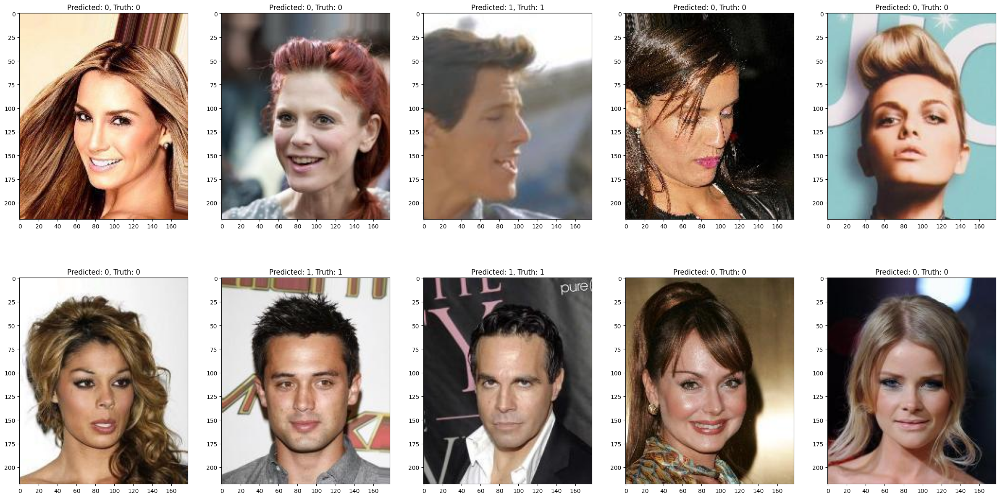

In [10]:
plot_sample(vggface_model, celeb_sample, transformation('vggface2'), device)

CASIA-WEBPAGE

In [11]:
casia_result_path = result_root / 'celeb_results_casia' / 'lightning_logs' / 'version_0'

In [12]:
get_metrics(str(casia_result_path / 'metrics.csv'))

Untrained Test Accuracy:	39.0191%
Final Test Accuracy:		97.4554%


In [13]:
# run model
casia_model = MLPClassifierWrapper.load_from_checkpoint(str(casia_result_path / 'checkpoints' / 'epoch=4-val_loss=0.08.ckpt'))
# set trained model
casia_model.trained_model = get_pretrained_model('casia', device)

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


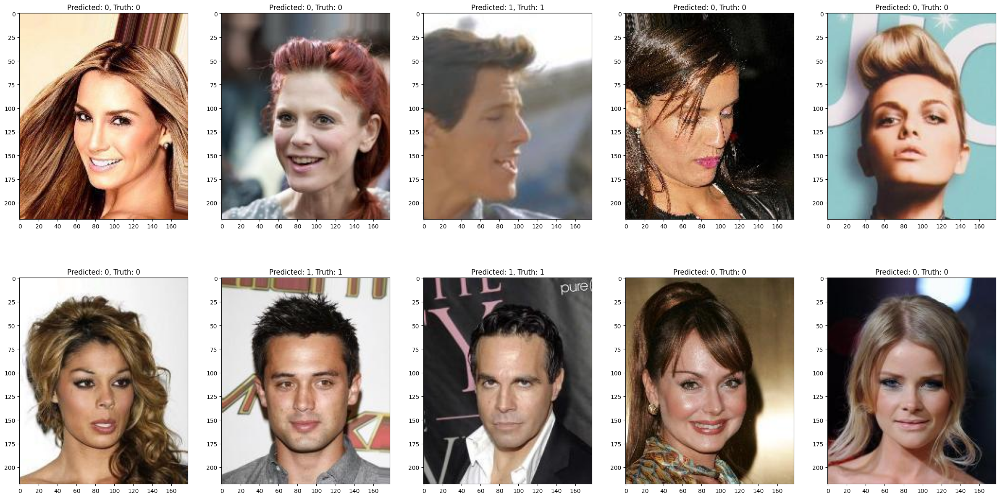

In [14]:
plot_sample(casia_model, celeb_sample, transformation('casia'), device)

VGG16 - Image Net

- Simply predicts everything as 0 (fails) hence 60% accuracy which is roughly the ratio of female to male

In [15]:
vgg16_result_path = result_root / 'celeb_results_vgg16' / 'lightning_logs' / 'version_0'

In [16]:
get_metrics(str(vgg16_result_path / 'metrics.csv'))

Untrained Test Accuracy:	64.6553%
Final Test Accuracy:		60.9809%


In [17]:
# run model
vgg16_model = MLPClassifierWrapper(input_features = 4096)
vgg16_model.load_state_dict(torch.load(str(vgg16_result_path / 'checkpoints' / 'epoch=0-val_loss=38.75.ckpt'))['state_dict'])
# set trained model
vgg16_model.trained_model = get_pretrained_model('vgg16', device)

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


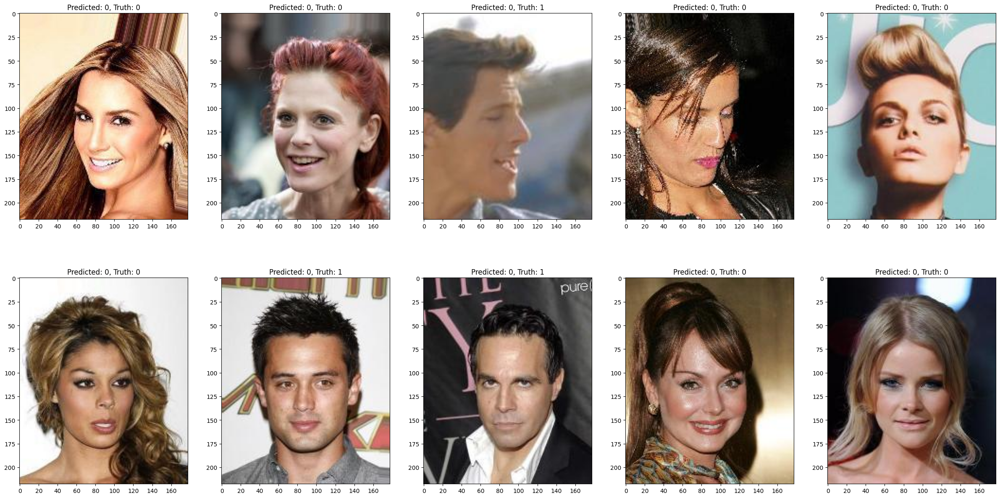

In [18]:
plot_sample(vgg16_model,celeb_sample, transformation('vgg16'), device)

VGGFACE2 Works the best!

# Ethnicity Gender Classification

In [19]:
def pprint(results):
    print(" "*15, end = '')
    for col in results.columns:
        print(f'|{col:^15}', end = '')
    print()
    print('-' * (15 * 8 + 7))
    print(f"{'initial':^15}", end = '')
    for col in results.columns:
        print(f'|{results[col][0]:^15.3f}', end = '')
    print()
    print(f"{'final':^15}", end = '')
    for col in results.columns:
        print(f'|{results[col][1]:^15.3f}', end = '')
    print()

All Results

In [20]:
fface_results = result_root / 'fface_results_vggface2/lightning_logs/version_0'

In [21]:
results = pd.read_csv(str(fface_results / 'results.csv'))

In [22]:
results

,white,black,ea,ind,lh,me,se
0,0.515038,0.500036,0.500325,0.517745,0.496664,0.688921,0.519820
1,0.929109,0.754079,0.820481,0.871847,0.903402,0.922110,0.838084


In [23]:
pprint(results)

               |     white     |     black     |      ea       |      ind      |      lh       |      me       |      se       
-------------------------------------------------------------------------------------------------------------------------------
    initial    |     0.515     |     0.500     |     0.500     |     0.518     |     0.497     |     0.689     |     0.520     
     final     |     0.929     |     0.754     |     0.820     |     0.872     |     0.903     |     0.922     |     0.838     


Observations:
```
    - Baseline white prediction is about .93 (could be impacted by a smaller test set due to needing to split up data for training)
    - Predicting black ethnicities is significantly worse for a model trained on white ethnicities.
    - There is a 10% drop in accuracy for EA & SE which are both asians
    - The others do not fare too poorly in prediction

    - Although not evident here, there is some overfitting when training the model, which could be mitigated using regularization techniques like dropout or L2, but is outside the scope of this project
```

Samples

In [24]:
# run model
fface_model = MLPClassifierWrapper.load_from_checkpoint(str(fface_results / 'checkpoints' / 'epoch=1-val_loss=0.19.ckpt'))
# set trained model
fface_model.trained_model = get_pretrained_model('vggface2', device)

In [25]:
fface_data = FairFaceData(root = str(root), sample = True)

White

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


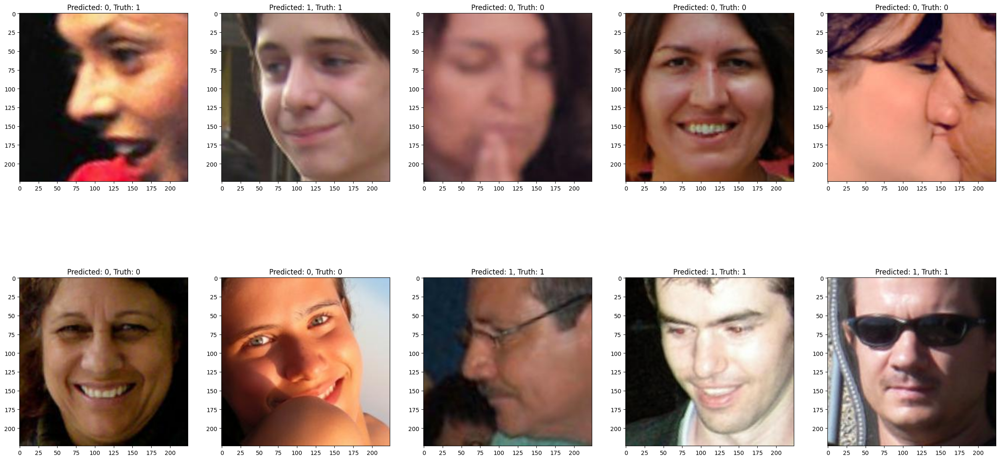

In [26]:
plot_sample(fface_model,fface_data.filter_dataset({'race': 'White'}) , transformation('vggface2'), device)

Black

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


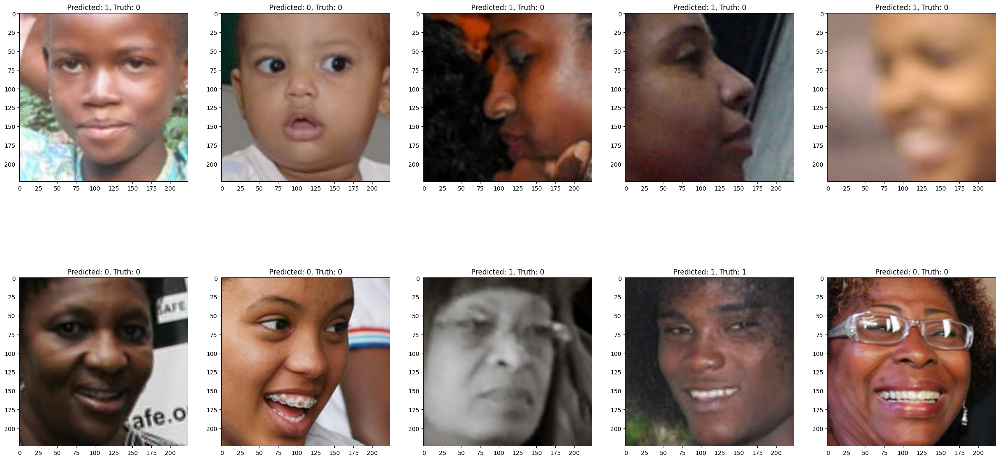

In [27]:
plot_sample(fface_model,fface_data.filter_dataset({'race': 'Black'}) , transformation('vggface2'), device)

East Asian

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


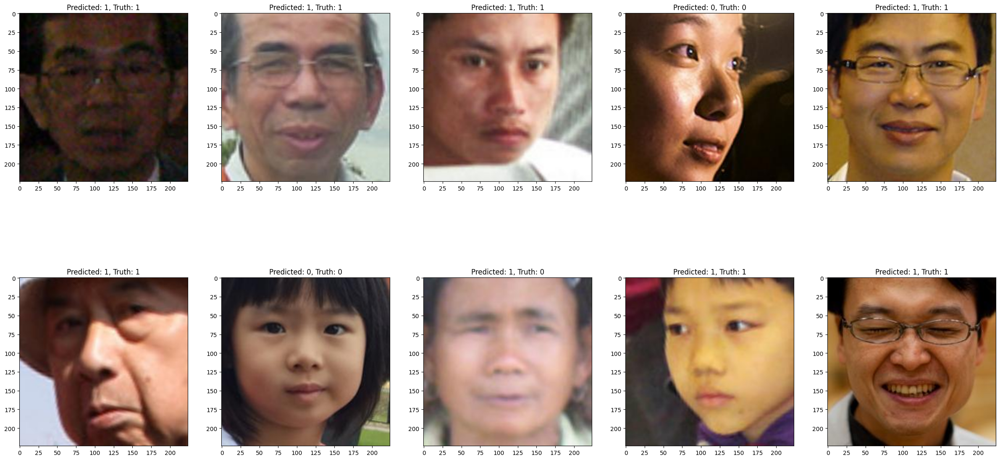

In [28]:
plot_sample(fface_model,fface_data.filter_dataset({'race': 'East Asian'}) , transformation('vggface2'), device)

Southeast Asian

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


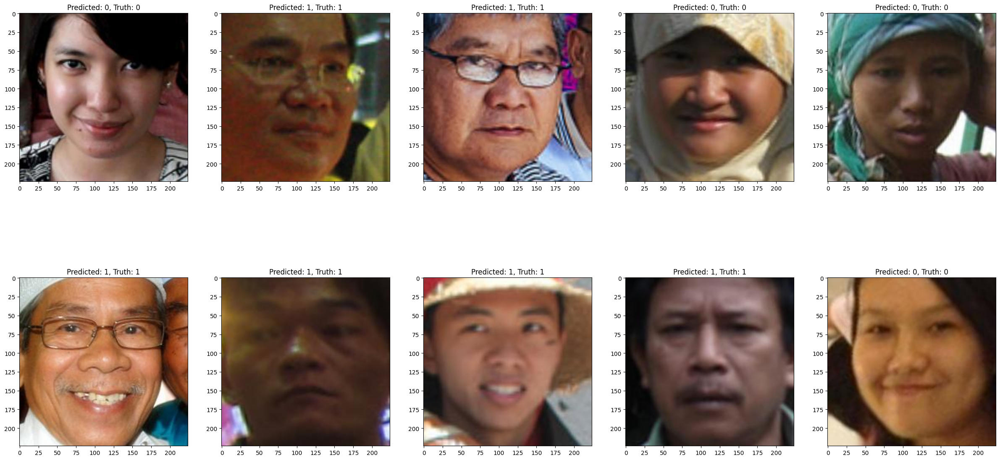

In [29]:
plot_sample(fface_model,fface_data.filter_dataset({'race': 'Southeast Asian'}) , transformation('vggface2'), device)

Indian

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


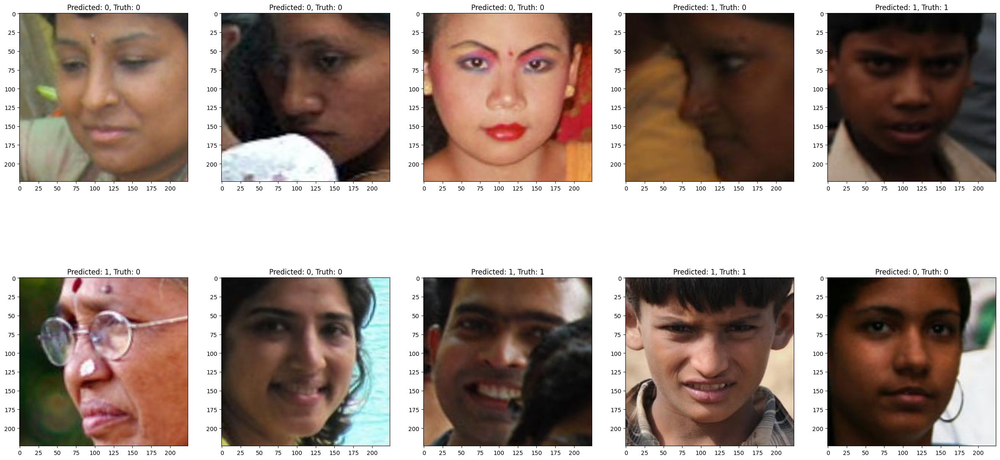

In [30]:
plot_sample(fface_model,fface_data.filter_dataset({'race': 'Indian'}) , transformation('vggface2'), device)

Latino/Hispanic

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


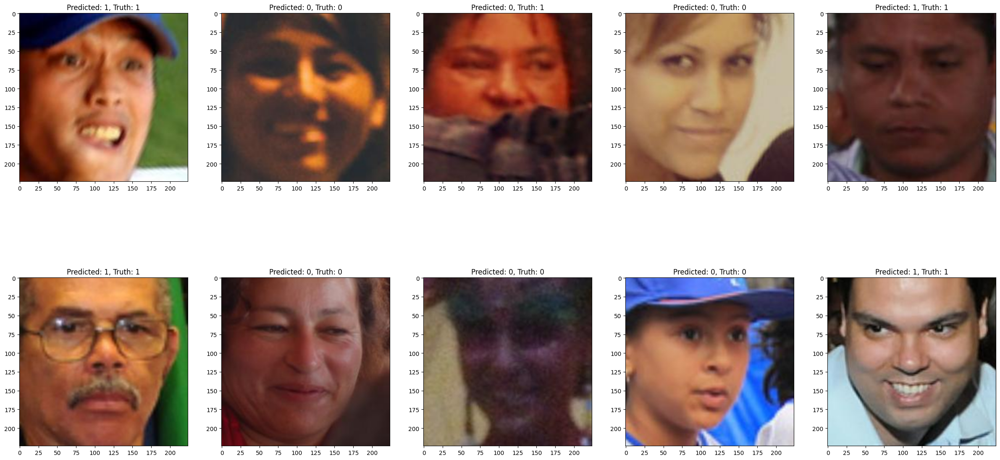

In [31]:
plot_sample(fface_model,fface_data.filter_dataset({'race': 'Latino_Hispanic'}) , transformation('vggface2'), device)

Middle Eastern

C:\Users\johnd\AppData\Local\Temp\ipykernel_9548\2469806780.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


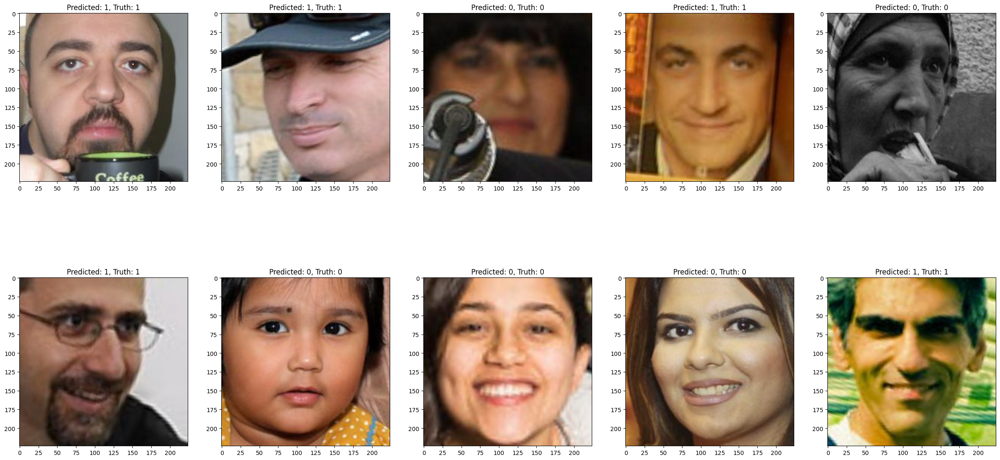

In [32]:
plot_sample(fface_model,fface_data.filter_dataset({'race': 'Middle Eastern'}) , transformation('vggface2'), device)